In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

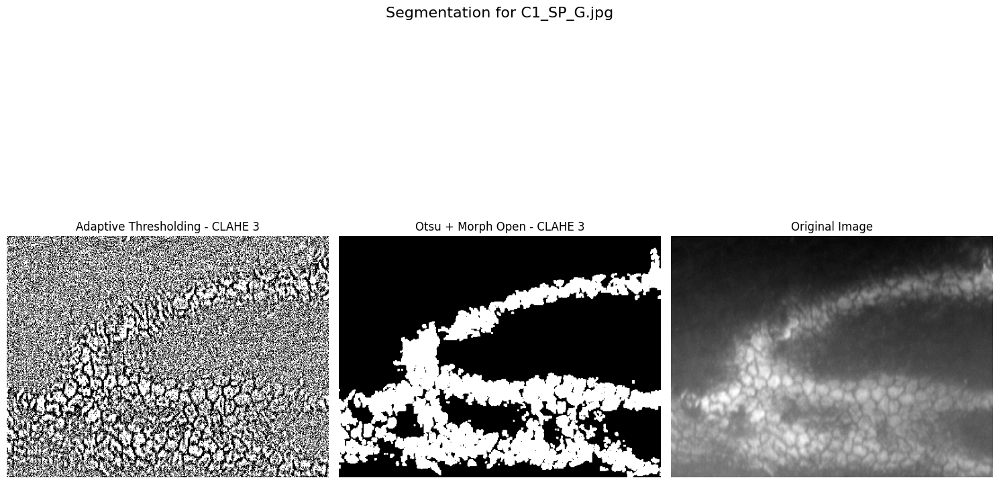

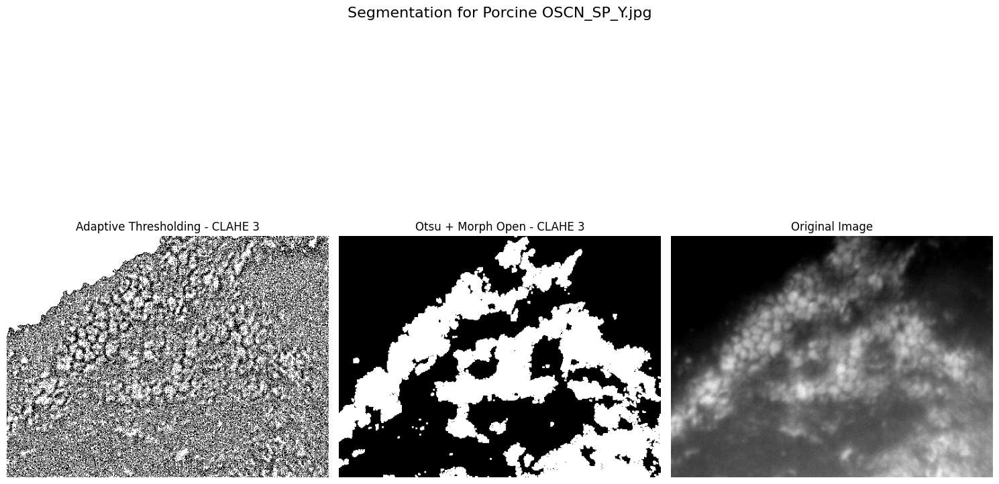

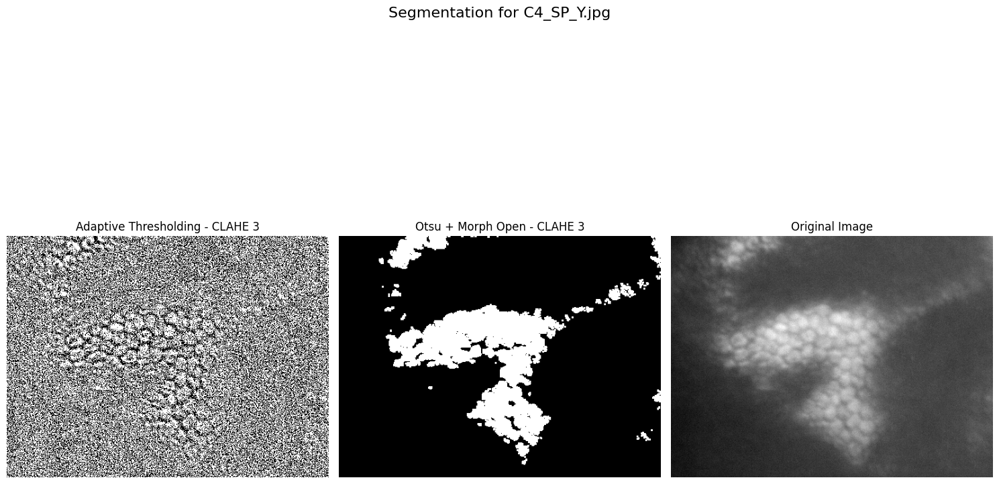

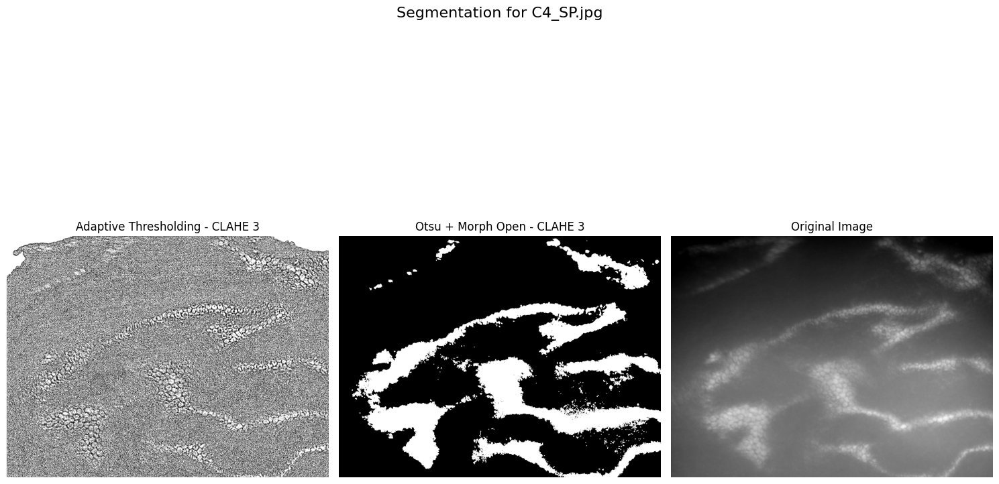

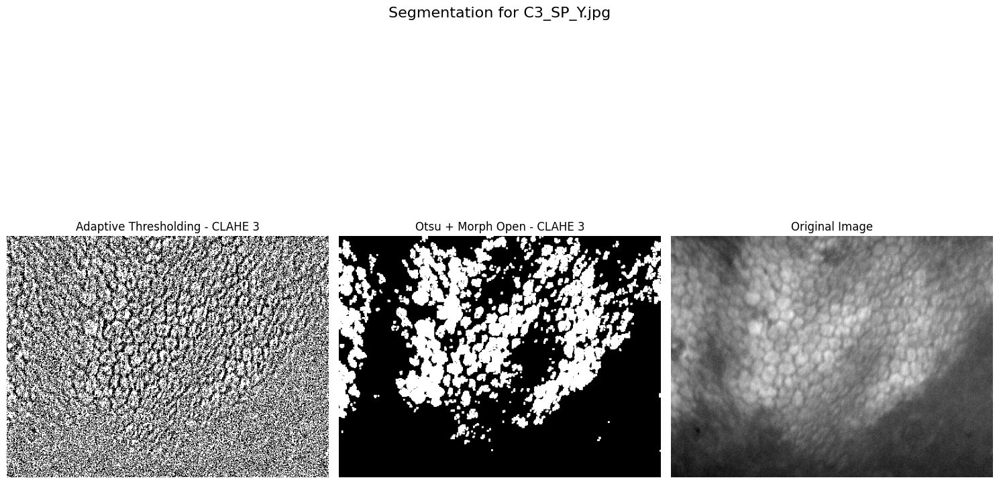

...

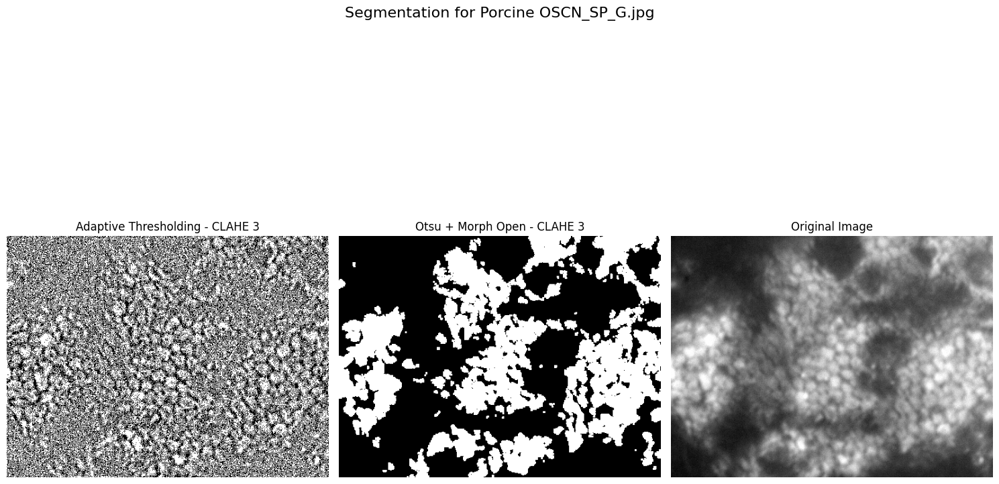

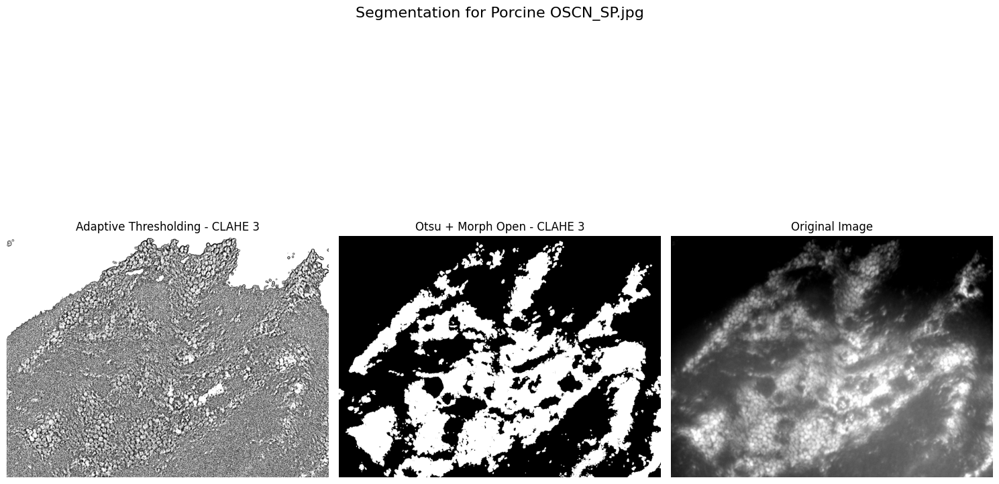

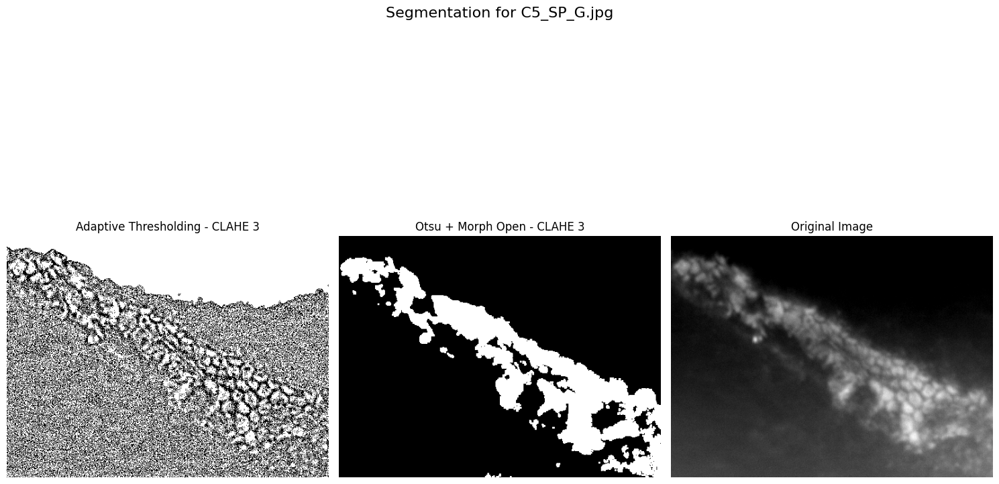

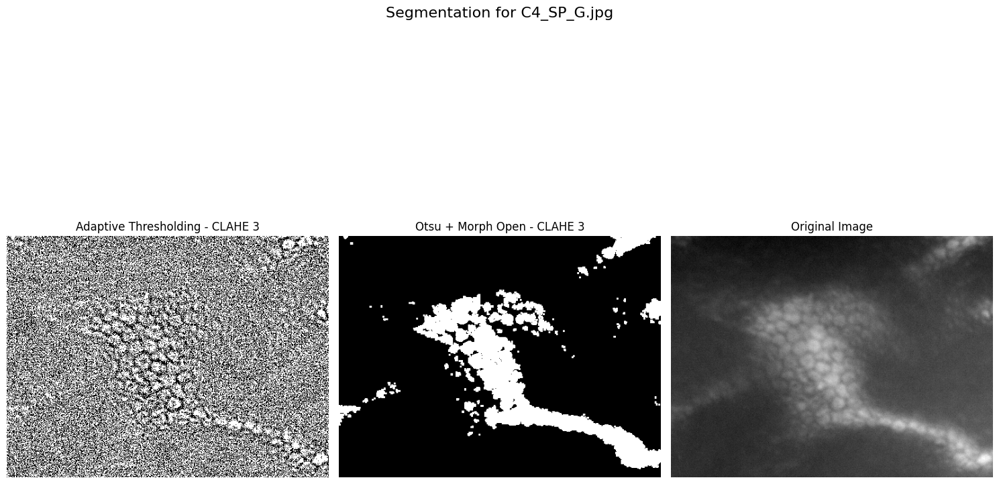

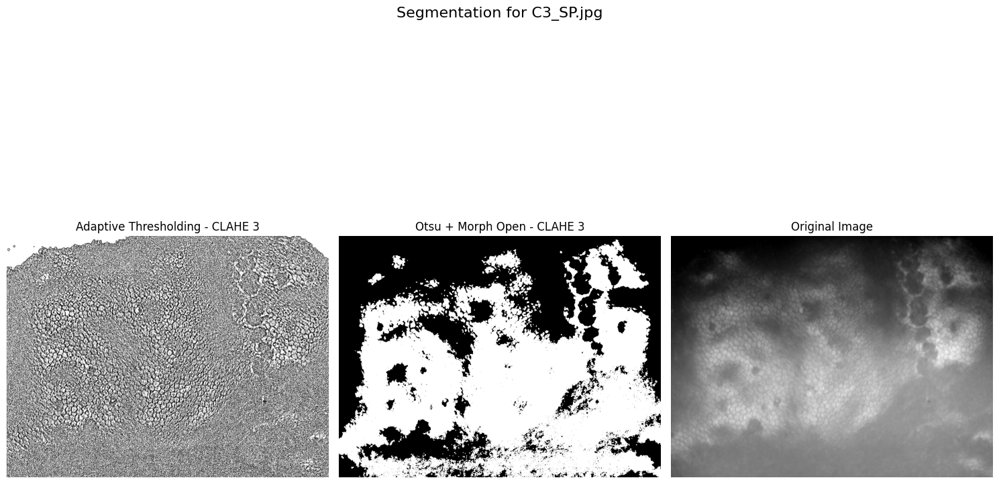

In [25]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

# Path to images directory
image_dir = "images"
image_files = [f for f in os.listdir(image_dir) if f.lower().endswith(('.png', '.jpg', '.jpeg', '.tif', '.bmp'))]

# Define CLAHE settings
clahe_2 = cv2.createCLAHE(clipLimit=2, tileGridSize=(8, 8))
clahe_3 = cv2.createCLAHE(clipLimit=3, tileGridSize=(8, 8))

# Kernel for morphological processing
kernel = np.ones((3, 3), np.uint8)

# Process each image
for file_name in image_files:
    image_path = os.path.join(image_dir, file_name)
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    if image is None:
        print(f"Skipping {file_name}, unable to read image.")
        continue

    # Apply CLAHE (Clip Limit 2 and 3) - No Blur
    image_clahe_2 = clahe_2.apply(image)
    image_clahe_3 = clahe_3.apply(image)

    # 1. Adaptive Thresholding
    adaptive_2 = cv2.adaptiveThreshold(image_clahe_2, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 2)
    adaptive_3 = cv2.adaptiveThreshold(image_clahe_3, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 2)

    # 2. Otsu's Thresholding with Morphological Opening (removes noise)
    _, otsu_2 = cv2.threshold(image_clahe_2, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    _, otsu_3 = cv2.threshold(image_clahe_3, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    otsu_2_clean = cv2.morphologyEx(otsu_2, cv2.MORPH_OPEN, kernel)
    otsu_3_clean = cv2.morphologyEx(otsu_3, cv2.MORPH_OPEN, kernel)

    # 3. Watershed Algorithm (Better Boundary Detection)
    # Convert Otsu mask into sure foreground and sure background
    dist_transform_2 = cv2.distanceTransform(otsu_2, cv2.DIST_L2, 5)
    dist_transform_3 = cv2.distanceTransform(otsu_3, cv2.DIST_L2, 5)

    _, sure_fg_2 = cv2.threshold(dist_transform_2, 0.2 * dist_transform_2.max(), 255, 0)
    _, sure_fg_3 = cv2.threshold(dist_transform_3, 0.2 * dist_transform_3.max(), 255, 0)

    # Apply watershed segmentation
    markers_2 = np.int32(sure_fg_2)
    markers_3 = np.int32(sure_fg_3)

    markers_2[otsu_2 == 255] = -1  # Mark background
    markers_3[otsu_3 == 255] = -1

    markers_2 = cv2.watershed(cv2.cvtColor(image_clahe_2, cv2.COLOR_GRAY2BGR), markers_2)
    markers_3 = cv2.watershed(cv2.cvtColor(image_clahe_3, cv2.COLOR_GRAY2BGR), markers_3)

    # Convert watershed markers to a binary mask
    watershed_2 = np.where(markers_2 == -1, 255, 0).astype(np.uint8)
    watershed_3 = np.where(markers_3 == -1, 255, 0).astype(np.uint8)

    # Display results
    fig, axes = plt.subplots(1, 3, figsize=(15, 10))
    fig.suptitle(f"Segmentation for {file_name}", fontsize=16)

    # First row: CLAHE 3 (No Blur) and Original
    axes[0].imshow(adaptive_3, cmap="gray")
    axes[0].set_title("Adaptive Thresholding - CLAHE 3")

    axes[1].imshow(otsu_3_clean, cmap="gray")
    axes[1].set_title("Otsu + Morph Open - CLAHE 3")

    axes[2].imshow(image, cmap="gray")
    axes[2].set_title("Original Image")

    # Remove axes labels
    for ax in axes.flatten():
        ax.axis("off")

    plt.tight_layout()
    plt.subplots_adjust(top=0.9)  # Adjust title position
    plt.show()


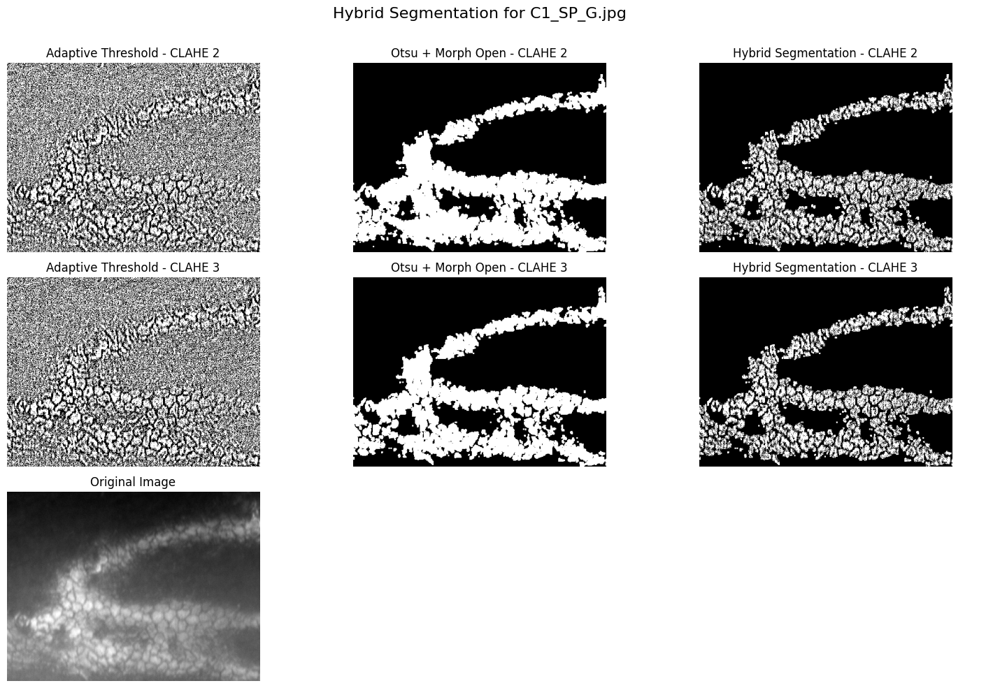

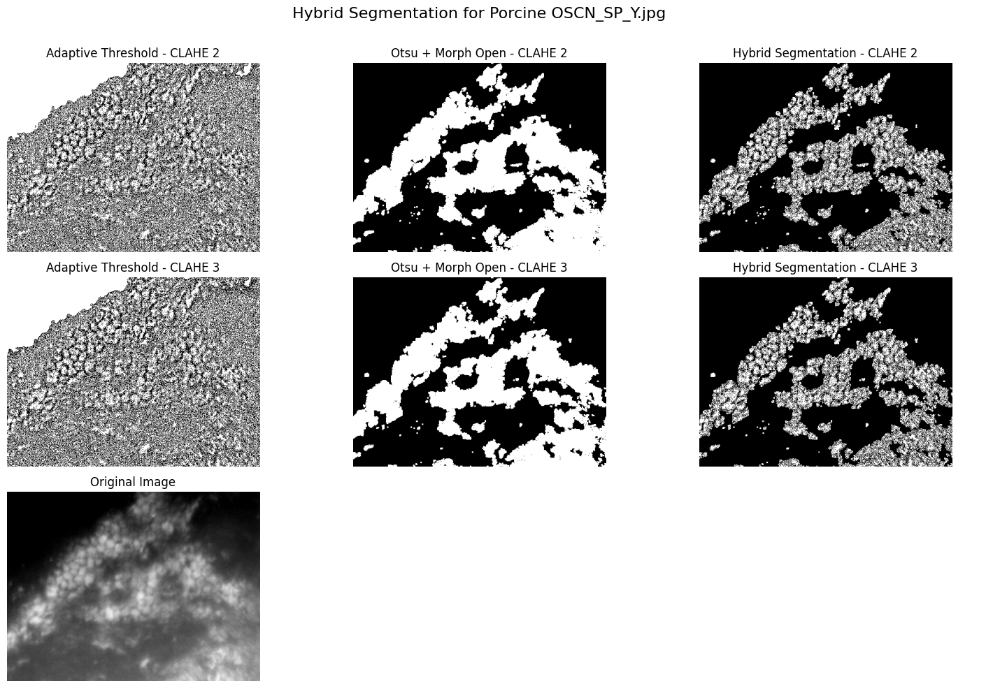

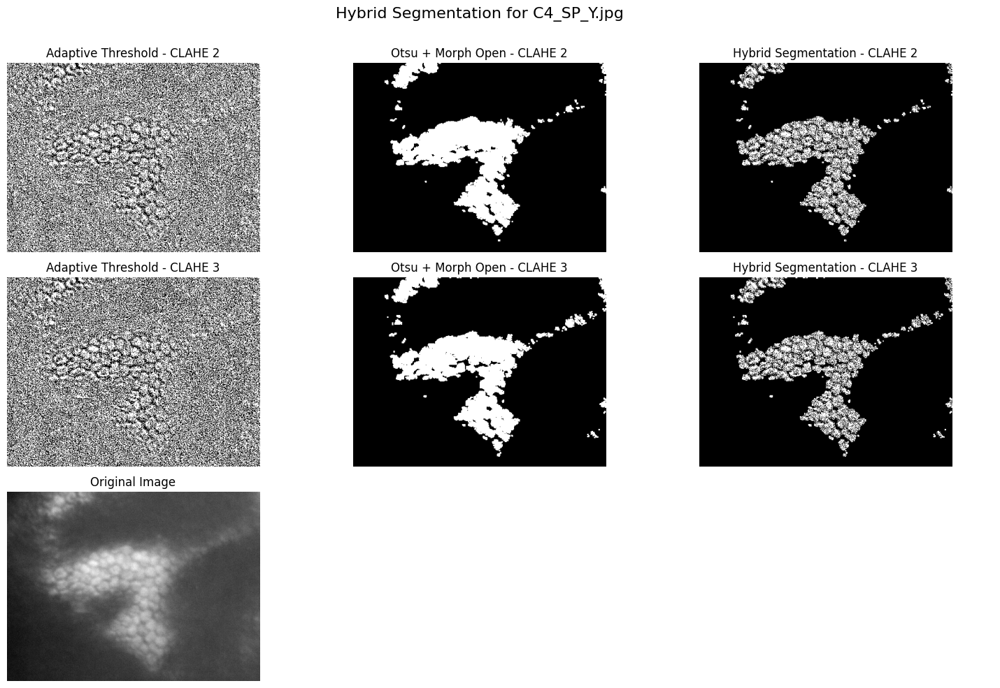

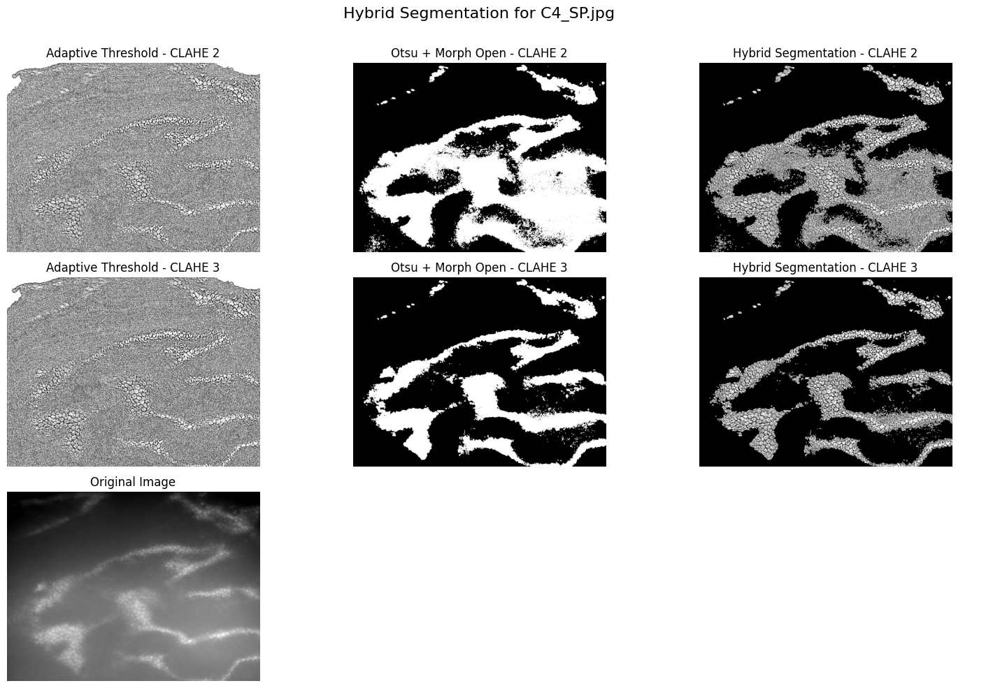

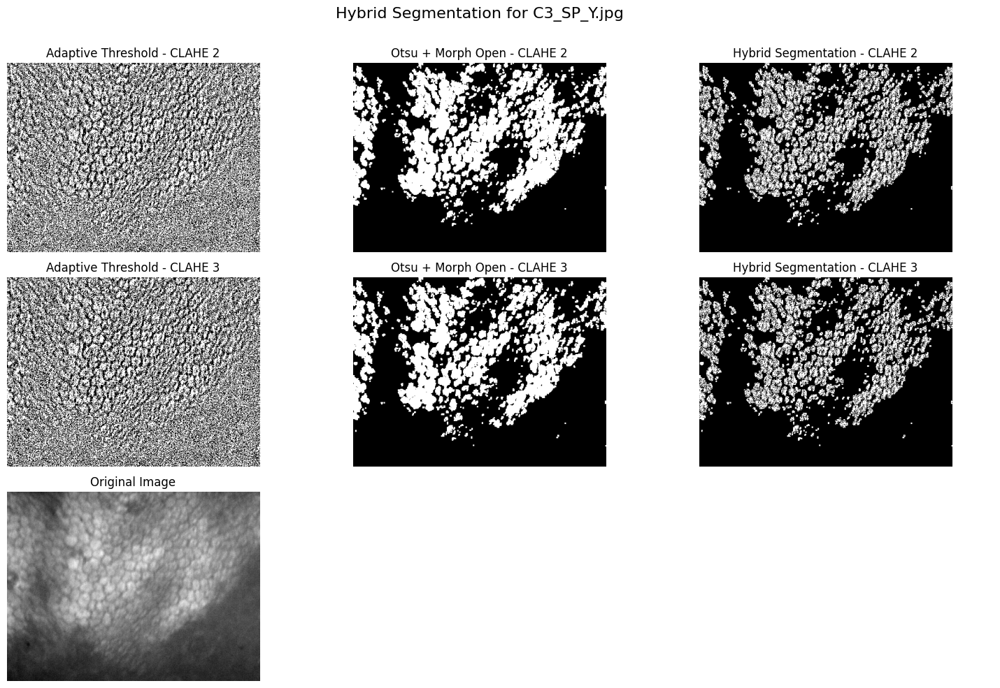

...

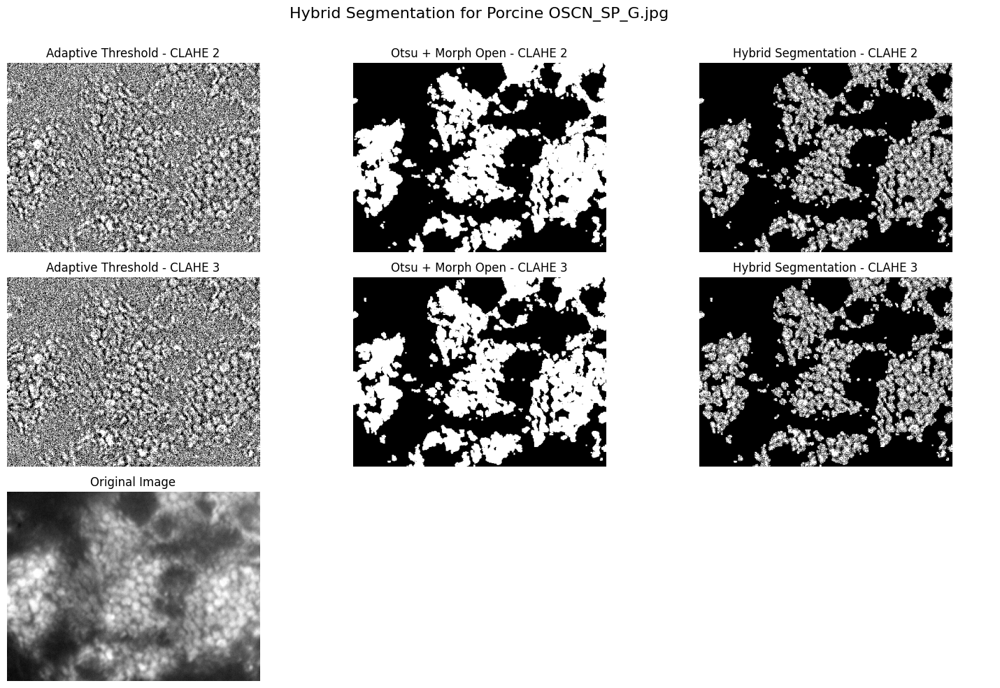

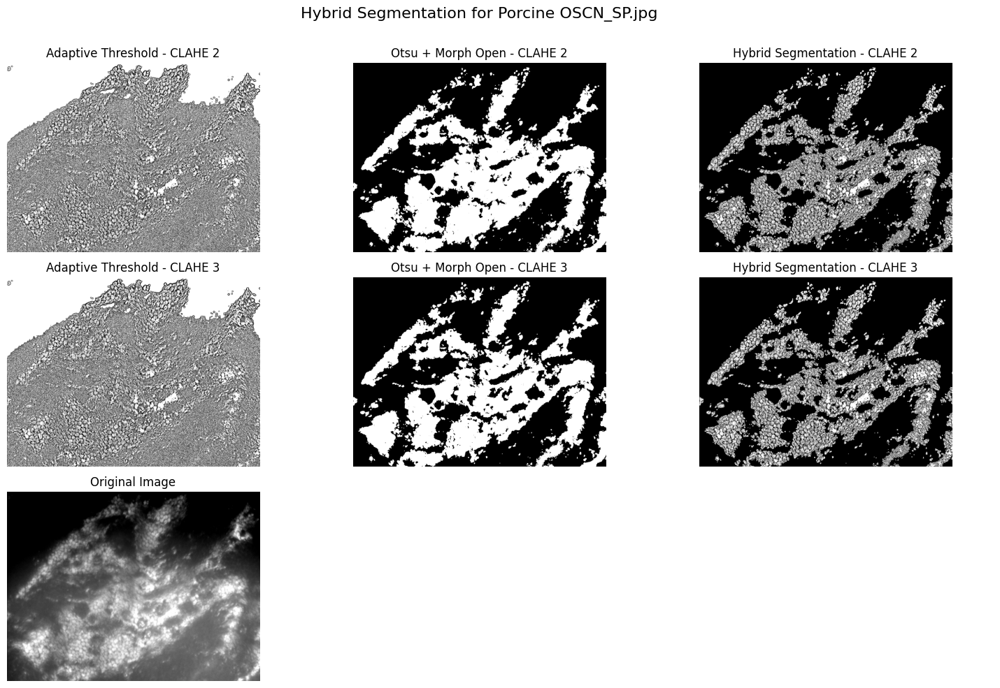

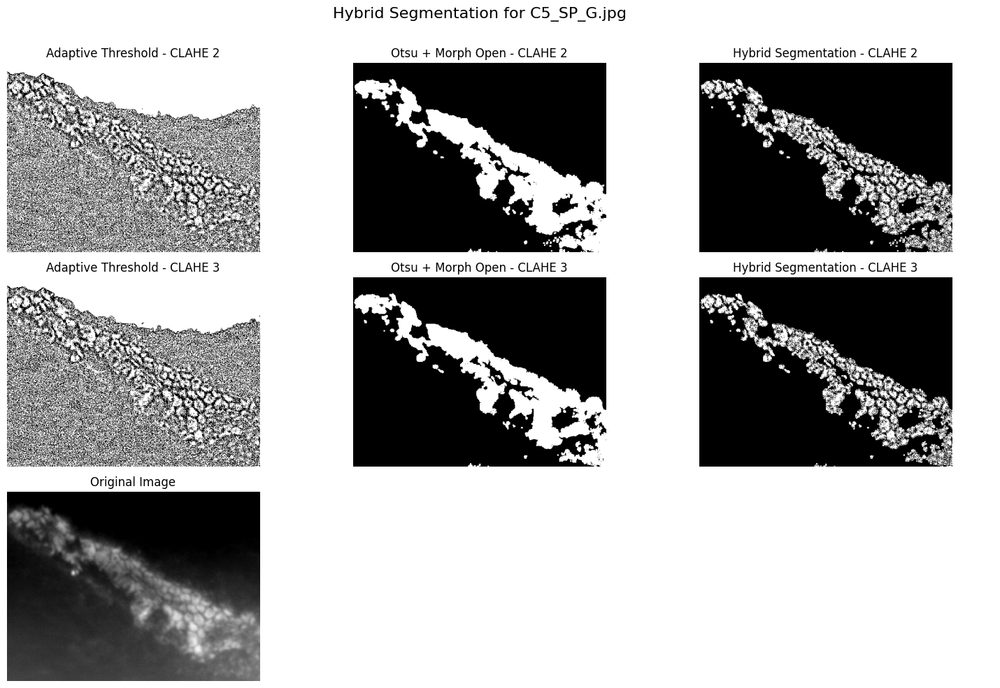

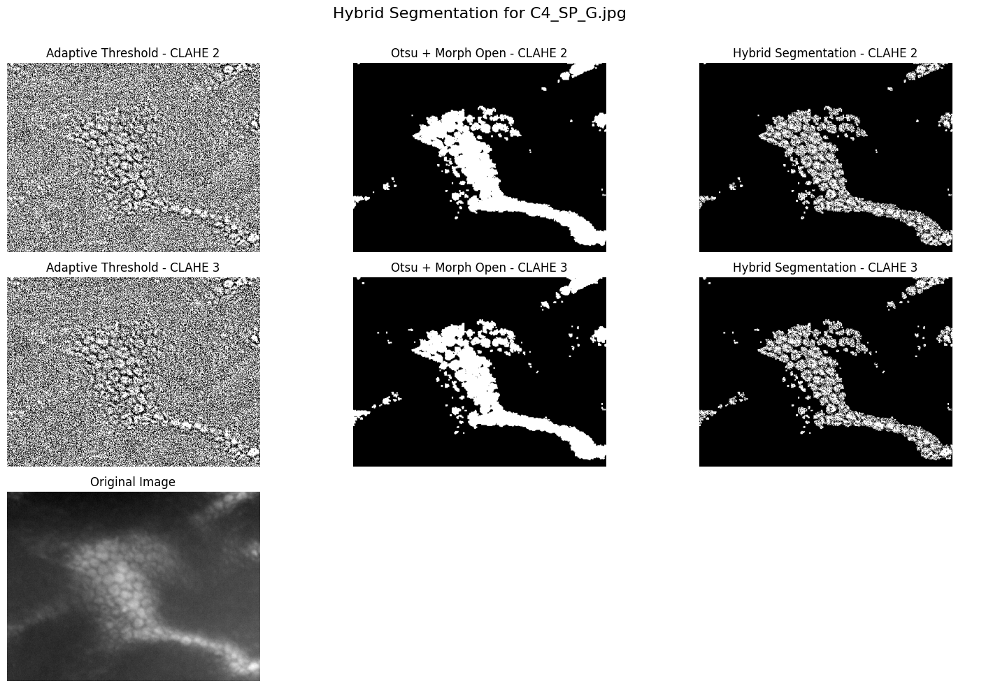

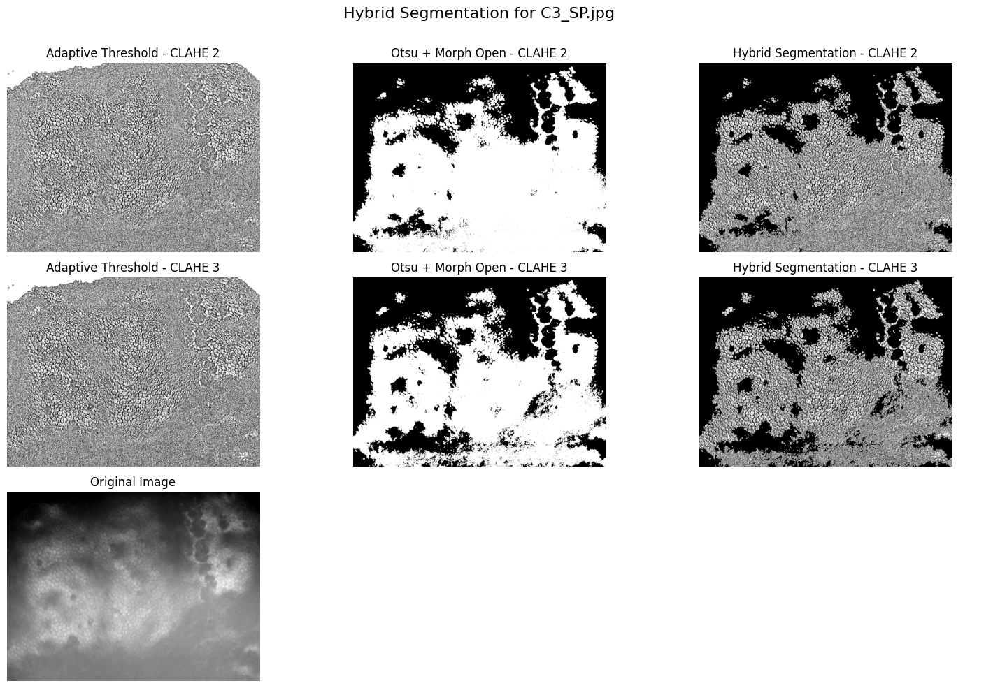

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

# Path to images directory
image_dir = "images"
image_files = [f for f in os.listdir(image_dir) if f.lower().endswith(('.png', '.jpg', '.jpeg', '.tif', '.bmp'))]

# Define CLAHE settings
clahe_2 = cv2.createCLAHE(clipLimit=2, tileGridSize=(8, 8))
clahe_3 = cv2.createCLAHE(clipLimit=3, tileGridSize=(8, 8))

# Kernel for morphological processing
kernel = np.ones((3, 3), np.uint8)

# Process each image
for file_name in image_files:
    image_path = os.path.join(image_dir, file_name)
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    if image is None:
        print(f"Skipping {file_name}, unable to read image.")
        continue

    # Apply CLAHE (Clip Limit 2 and 3) - No Blur
    image_clahe_2 = clahe_2.apply(image)
    image_clahe_3 = clahe_3.apply(image)

    # 1. Adaptive Thresholding
    adaptive_2 = cv2.adaptiveThreshold(image_clahe_2, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 2)
    adaptive_3 = cv2.adaptiveThreshold(image_clahe_3, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 2)

    # 2. Otsu's Thresholding with Morphological Opening (removes noise)
    _, otsu_2 = cv2.threshold(image_clahe_2, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    _, otsu_3 = cv2.threshold(image_clahe_3, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    otsu_2_clean = cv2.morphologyEx(otsu_2, cv2.MORPH_OPEN, kernel)
    otsu_3_clean = cv2.morphologyEx(otsu_3, cv2.MORPH_OPEN, kernel)

    # 3. Hybrid Segmentation: Apply Otsu’s black regions onto Adaptive
    hybrid_2 = np.where(otsu_2_clean == 0, 0, adaptive_2)
    hybrid_3 = np.where(otsu_3_clean == 0, 0, adaptive_3)

    # Display results
    fig, axes = plt.subplots(1, 4, figsize=(15, 10))
    fig.suptitle(f"Hybrid Segmentation for {file_name}", fontsize=16)

    # First row: CLAHE 3 (No Blur)
    axes[0].imshow(adaptive_3, cmap="gray")
    axes[0].set_title("Adaptive Threshold - CLAHE 3")

    axes[1].imshow(otsu_3_clean, cmap="gray")
    axes[1].set_title("Otsu + Morph Open - CLAHE 3")

    axes[2].imshow(hybrid_3, cmap="gray")
    axes[2].set_title("Hybrid Segmentation - CLAHE 3")

    axes[3].imshow(image, cmap="gray")
    axes[3].set_title("Original Image")

    # Remove axes labels for cleaner visualization
    for ax in axes.flatten():
        ax.axis("off")

    plt.tight_layout()
    plt.subplots_adjust(top=0.9)  # Adjust title positioning
    plt.show()
